<a href="https://colab.research.google.com/github/KARAVAGE/Filetrage_de_image/blob/main/Fillter.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# **Filtre passe-bass**

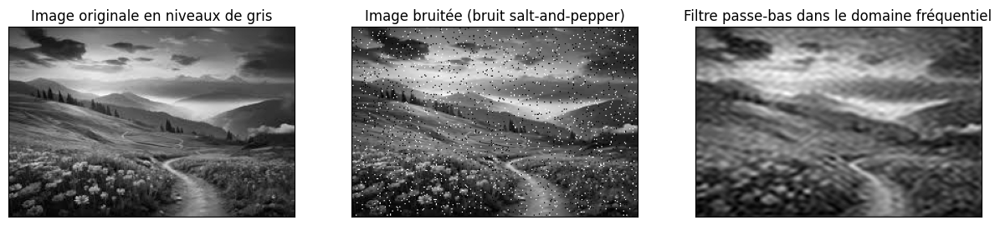

In [ ]:
from google.colab import drive
import cv2
import numpy as np
from matplotlib import pyplot as plt

# Monter Google Drive
# drive.mount('/content/drive')

# Chemin de l'image dans votre Google Drive
image_path = 'image.jpg'

# Charger l'image en niveaux de gris
image_gray = cv2.imread(image_path, cv2.IMREAD_GRAYSCALE)

# Ajouter du bruit salt-and-pepper à l'image
def add_salt_and_pepper_noise(image, amount):
    noisy_image = np.copy(image)
    height, width = image.shape
    num_salt = np.ceil(amount * image.size * 0.5)
    num_pepper = np.ceil(amount * image.size * 0.5)
    # Ajouter du bruit salt
    coords = [np.random.randint(0, i - 1, int(num_salt)) for i in image.shape]
    noisy_image[coords[0], coords[1]] = 255
    # Ajouter du bruit pepper
    coords = [np.random.randint(0, i - 1, int(num_pepper)) for i in image.shape]
    noisy_image[coords[0], coords[1]] = 0
    return noisy_image

# Appliquer le bruit salt-and-pepper à l'image
noisy_image_gray = add_salt_and_pepper_noise(image_gray, amount=0.05)  # Ajustez la quantité selon vos besoins

# Transformer l'image en domaine fréquentiel
f = np.fft.fft2(noisy_image_gray)
fshift = np.fft.fftshift(f)

# Créer un masque passe-bas
rows, cols = noisy_image_gray.shape
crow, ccol = rows // 2, cols // 2
mask = np.zeros((rows, cols), np.uint8)
mask[crow - 30:crow + 30, ccol - 30:ccol + 30] = 1

# Appliquer le masque au spectre de Fourier
fshift_filtered = fshift * mask

# Récupérer l'image filtrée dans le domaine spatial
f_ishift = np.fft.ifftshift(fshift_filtered)
img_back = np.fft.ifft2(f_ishift)
img_back = np.abs(img_back)

# Afficher l'image originale, l'image bruitée et l'image filtrée
plt.figure(figsize=(15, 10))
plt.subplot(131), plt.imshow(image_gray, cmap='gray')
plt.title('Image originale en niveaux de gris'), plt.xticks([]), plt.yticks([])
plt.subplot(132), plt.imshow(noisy_image_gray, cmap='gray')
plt.title('Image bruitée (bruit salt-and-pepper)'), plt.xticks([]), plt.yticks([])
plt.subplot(133), plt.imshow(img_back, cmap='gray')
plt.title('Filtre passe-bas dans le domaine fréquentiel'), plt.xticks([]), plt.yticks([])
plt.show()


# **Filtre passe-haut**

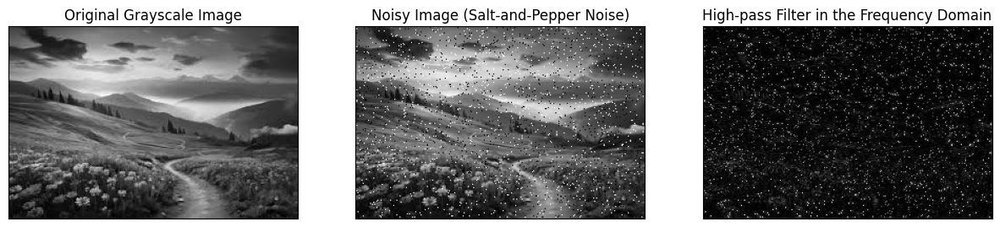

In [ ]:
from google.colab import drive
import cv2
import numpy as np
from matplotlib import pyplot as plt

# Mount Google Drive
# drive.mount('/content/drive')

# Path to the image in your Google Drive
image_path = 'image.jpg'

# Load the image in grayscale
image_gray = cv2.imread(image_path, cv2.IMREAD_GRAYSCALE)

# Add salt-and-pepper noise to the image
def add_salt_and_pepper_noise(image, amount):
    noisy_image = np.copy(image)
    height, width = image.shape
    num_salt = np.ceil(amount * image.size * 0.5)
    num_pepper = np.ceil(amount * image.size * 0.5)
    # Add salt noise
    coords = [np.random.randint(0, i - 1, int(num_salt)) for i in image.shape]
    noisy_image[coords[0], coords[1]] = 255
    # Add pepper noise
    coords = [np.random.randint(0, i - 1, int(num_pepper)) for i in image.shape]
    noisy_image[coords[0], coords[1]] = 0
    return noisy_image

# Apply salt-and-pepper noise to the image
noisy_image_gray = add_salt_and_pepper_noise(image_gray, amount=0.05)  # Adjust the amount as needed

# Convert the image to the frequency domain
f = np.fft.fft2(noisy_image_gray)
fshift = np.fft.fftshift(f)

# Create a high-pass mask
rows, cols = noisy_image_gray.shape
crow, ccol = rows // 2, cols // 2
mask = np.ones((rows, cols), np.uint8)
mask[crow - 30:crow + 30, ccol - 30:ccol + 30] = 0

# Apply the mask to the Fourier spectrum
fshift_filtered = fshift * mask

# Retrieve the filtered image in the spatial domain
f_ishift = np.fft.ifftshift(fshift_filtered)
img_back = np.fft.ifft2(f_ishift)
img_back = np.abs(img_back)

# Display the original image, the noisy image, and the filtered image
plt.figure(figsize=(15, 10))
plt.subplot(131), plt.imshow(image_gray, cmap='gray')
plt.title('Original Grayscale Image'), plt.xticks([]), plt.yticks([])
plt.subplot(132), plt.imshow(noisy_image_gray, cmap='gray')
plt.title('Noisy Image (Salt-and-Pepper Noise)'), plt.xticks([]), plt.yticks([])
plt.subplot(133), plt.imshow(img_back, cmap='gray')
plt.title('High-pass Filter in the Frequency Domain'), plt.xticks([]), plt.yticks([])
plt.show()


# **Filtre de réjection de fréquence**

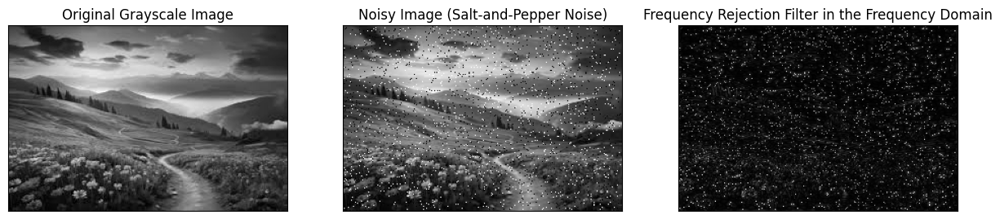

In [ ]:
from google.colab import drive
import cv2
import numpy as np
from matplotlib import pyplot as plt

# Mount Google Drive
# drive.mount('/content/drive')

# Path to the image in your Google Drive
image_path = 'image.jpg'

# Load the image in grayscale
image_gray = cv2.imread(image_path, cv2.IMREAD_GRAYSCALE)

# Add salt-and-pepper noise to the image
def add_salt_and_pepper_noise(image, amount):
    noisy_image = np.copy(image)
    height, width = image.shape
    num_salt = np.ceil(amount * image.size * 0.5)
    num_pepper = np.ceil(amount * image.size * 0.5)
    # Add salt noise
    coords = [np.random.randint(0, i - 1, int(num_salt)) for i in image.shape]
    noisy_image[coords[0], coords[1]] = 255
    # Add pepper noise
    coords = [np.random.randint(0, i - 1, int(num_pepper)) for i in image.shape]
    noisy_image[coords[0], coords[1]] = 0
    return noisy_image

# Apply salt-and-pepper noise to the image
noisy_image_gray = add_salt_and_pepper_noise(image_gray, amount=0.05)  # Adjust the amount as needed

# Convert the image to the frequency domain
f = np.fft.fft2(noisy_image_gray)
fshift = np.fft.fftshift(f)

# Create a frequency rejection mask
rows, cols = noisy_image_gray.shape
crow, ccol = rows // 2, cols // 2
mask = np.ones((rows, cols), np.uint8)
mask[crow - 30:crow + 30, ccol - 30:ccol + 30] = 0

# Apply the mask to the Fourier spectrum
fshift_filtered = fshift * mask

# Retrieve the filtered image in the spatial domain
f_ishift = np.fft.ifftshift(fshift_filtered)
img_back = np.fft.ifft2(f_ishift)
img_back = np.abs(img_back)

# Display the original image, the noisy image, and the filtered image
plt.figure(figsize=(15, 10))
plt.subplot(131), plt.imshow(image_gray, cmap='gray')
plt.title('Original Grayscale Image'), plt.xticks([]), plt.yticks([])
plt.subplot(132), plt.imshow(noisy_image_gray, cmap='gray')
plt.title('Noisy Image (Salt-and-Pepper Noise)'), plt.xticks([]), plt.yticks([])
plt.subplot(133), plt.imshow(img_back, cmap='gray')
plt.title('Frequency Rejection Filter in the Frequency Domain'), plt.xticks([]), plt.yticks([])
plt.show()


# **One**

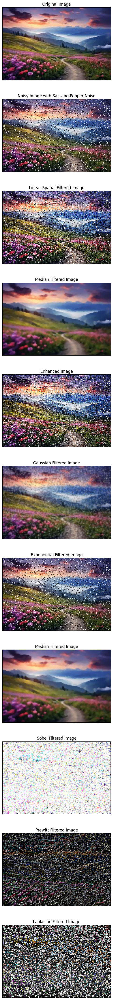

In [ ]:
from google.colab import drive
import cv2
import numpy as np
from matplotlib import pyplot as plt

# Mount Google Drive
# drive.mount('/content/drive')

# Path to the image in your Google Drive
image_path = 'image.jpg'

# Load the image
image_color = cv2.imread(image_path, cv2.IMREAD_COLOR)

# Add salt-and-pepper noise to the image
def add_salt_and_pepper_noise(image, amount):
    noisy_image = np.copy(image)
    height, width, _ = image.shape
    num_salt = np.ceil(amount * image.size * 0.5)
    num_pepper = np.ceil(amount * image.size * 0.5)
    # Add salt noise
    coords = [np.random.randint(0, i - 1, int(num_salt)) for i in image.shape]
    noisy_image[coords[0], coords[1], :] = 255
    # Add pepper noise
    coords = [np.random.randint(0, i - 1, int(num_pepper)) for i in image.shape]
    noisy_image[coords[0], coords[1], :] = 0
    return noisy_image

noisy_image_color = add_salt_and_pepper_noise(image_color, amount=0.05)  # Adjust amount as needed

# Define a custom kernel for linear spatial filtering
kernel = np.array([[0, -1, 0], [-1, 5, -1], [0, -1, 0]])  # Example kernel for edge enhancement

# Apply convolution with the custom kernel
filtered_image = cv2.filter2D(noisy_image_color, -1, kernel)

# Apply median filter for non-linear spatial filtering
median_filtered = cv2.medianBlur(noisy_image_color, 5)  # Adjust kernel size as needed

# Define a kernel for enhancement filtering
kernel_enhancement = np.array([[0, -1, 0],
                                [-1, 5, -1],
                                [0, -1, 0]])

# Apply convolution with the custom kernel for enhancement filtering
enhanced_image = cv2.filter2D(noisy_image_color, -1, kernel_enhancement)

# Apply Gaussian filter
gaussian_filtered = cv2.GaussianBlur(noisy_image_color, (5, 5), 0)  # Adjust kernel size and standard deviation as needed

# Apply exponential filter
exponential_filtered = cv2.fastNlMeansDenoisingColored(noisy_image_color, None, h=3, hColor=3, templateWindowSize=7, searchWindowSize=21)

# Apply median filter
median_filtered = cv2.medianBlur(noisy_image_color, 5)  # Adjust kernel size as needed

# Apply Sobel filter
sobel_filtered_x = cv2.Sobel(noisy_image_color, cv2.CV_64F, 1, 0, ksize=5)
sobel_filtered_y = cv2.Sobel(noisy_image_color, cv2.CV_64F, 0, 1, ksize=5)
sobel_filtered_x_abs = cv2.convertScaleAbs(sobel_filtered_x)
sobel_filtered_y_abs = cv2.convertScaleAbs(sobel_filtered_y)
sobel_filtered = cv2.addWeighted(sobel_filtered_x_abs, 0.5, sobel_filtered_y_abs, 0.5, 0)

# Apply Prewitt filter
prewitt_kernel_x = np.array([[1, 0, -1],
                              [1, 0, -1],
                              [1, 0, -1]])
prewitt_kernel_y = np.array([[1, 1, 1],
                              [0, 0, 0],
                              [-1, -1, -1]])
prewitt_filtered_x = cv2.filter2D(noisy_image_color, -1, prewitt_kernel_x)
prewitt_filtered_y = cv2.filter2D(noisy_image_color, -1, prewitt_kernel_y)
prewitt_filtered = cv2.addWeighted(prewitt_filtered_x, 0.5, prewitt_filtered_y, 0.5, 0)

# Apply Laplacian filter
laplacian_filtered = cv2.Laplacian(noisy_image_color, cv2.CV_64F)
laplacian_filtered = cv2.convertScaleAbs(laplacian_filtered)

# Plot the images vertically
plt.figure(figsize=(6, 60))

plt.subplot(12, 1, 1), plt.imshow(cv2.cvtColor(image_color, cv2.COLOR_BGR2RGB))
plt.title('Original Image'), plt.xticks([]), plt.yticks([])

plt.subplot(12, 1, 1), plt.imshow(cv2.cvtColor(image_color, cv2.COLOR_BGR2RGB))
plt.title('Original Image'), plt.xticks([]), plt.yticks([])

plt.subplot(12, 1, 2), plt.imshow(cv2.cvtColor(noisy_image_color, cv2.COLOR_BGR2RGB))
plt.title('Noisy Image with Salt-and-Pepper Noise'), plt.xticks([]), plt.yticks([])

plt.subplot(12, 1, 3), plt.imshow(cv2.cvtColor(filtered_image, cv2.COLOR_BGR2RGB))
plt.title('Linear Spatial Filtered Image'), plt.xticks([]), plt.yticks([])

plt.subplot(12, 1, 4), plt.imshow(cv2.cvtColor(median_filtered, cv2.COLOR_BGR2RGB))
plt.title('Median Filtered Image'), plt.xticks([]), plt.yticks([])

plt.subplot(12, 1, 5), plt.imshow(cv2.cvtColor(enhanced_image, cv2.COLOR_BGR2RGB))
plt.title('Enhanced Image'), plt.xticks([]), plt.yticks([])

plt.subplot(12, 1, 6), plt.imshow(cv2.cvtColor(gaussian_filtered, cv2.COLOR_BGR2RGB))
plt.title('Gaussian Filtered Image'), plt.xticks([]), plt.yticks([])

plt.subplot(12, 1, 7), plt.imshow(cv2.cvtColor(exponential_filtered, cv2.COLOR_BGR2RGB))
plt.title('Exponential Filtered Image'), plt.xticks([]), plt.yticks([])

plt.subplot(12, 1, 8), plt.imshow(cv2.cvtColor(median_filtered, cv2.COLOR_BGR2RGB))
plt.title('Median Filtered Image'), plt.xticks([]), plt.yticks([])

plt.subplot(12, 1, 9), plt.imshow(cv2.cvtColor(sobel_filtered, cv2.COLOR_BGR2RGB))
plt.title('Sobel Filtered Image'), plt.xticks([]), plt.yticks([])

plt.subplot(12, 1, 10), plt.imshow(cv2.cvtColor(prewitt_filtered, cv2.COLOR_BGR2RGB))
plt.title('Prewitt Filtered Image'), plt.xticks([]), plt.yticks([])

plt.subplot(12, 1, 11), plt.imshow(laplacian_filtered, cmap='gray')
plt.title('Laplacian Filtered Image'), plt.xticks([]), plt.yticks([])

plt.show()

# **two**

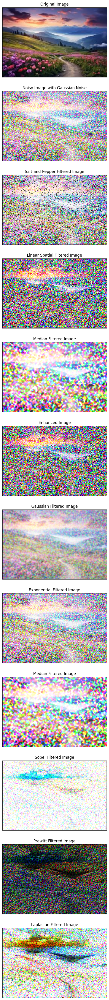

In [ ]:
from google.colab import drive
import cv2
import numpy as np
from matplotlib import pyplot as plt

# Mount Google Drive
# drive.mount('/content/drive')

# Path to the image in your Google Drive
image_path = 'image.jpg'

# Load the image
image_color = cv2.imread(image_path, cv2.IMREAD_COLOR)

# Add Gaussian noise to the image
def add_gaussian_noise(image, mean, sigma):
    noisy_image = np.copy(image)
    height, width, _ = image.shape
    gauss = np.random.normal(mean, sigma, (height, width, 3)).astype(np.uint8)  # Convert to uint8
    noisy_image = cv2.addWeighted(noisy_image, 1, gauss, 1, 0)
    return noisy_image


noisy_image_color = add_gaussian_noise(image_color, mean=0, sigma=25)  # Adjust mean and sigma as needed

# Apply salt-and-pepper filter to the noisy image
def add_salt_and_pepper_filter(image, salt_amount, pepper_amount):
    noisy_image = np.copy(image)
    height, width, _ = image.shape
    num_salt = np.ceil(salt_amount * image.size * 0.5)
    num_pepper = np.ceil(pepper_amount * image.size * 0.5)
    # Add salt noise
    salt_coords = [np.random.randint(0, i - 1, int(num_salt)) for i in image.shape]
    noisy_image[salt_coords[0], salt_coords[1], :] = 255
    # Add pepper noise
    pepper_coords = [np.random.randint(0, i - 1, int(num_pepper)) for i in image.shape]
    noisy_image[pepper_coords[0], pepper_coords[1], :] = 0
    return noisy_image

salt_and_pepper_filtered = add_salt_and_pepper_filter(noisy_image_color, salt_amount=0.05, pepper_amount=0.05)

# Define a custom kernel for linear spatial filtering
kernel = np.array([[0, -1, 0], [-1, 5, -1], [0, -1, 0]])  # Example kernel for edge enhancement

# Apply convolution with the custom kernel
filtered_image = cv2.filter2D(noisy_image_color, -1, kernel)

# Apply median filter for non-linear spatial filtering
median_filtered = cv2.medianBlur(noisy_image_color, 5)  # Adjust kernel size as needed

# Define a kernel for enhancement filtering
kernel_enhancement = np.array([[0, -1, 0],
                                [-1, 5, -1],
                                [0, -1, 0]])

# Apply convolution with the custom kernel for enhancement filtering
enhanced_image = cv2.filter2D(noisy_image_color, -1, kernel_enhancement)

# Apply Gaussian filter
gaussian_filtered = cv2.GaussianBlur(noisy_image_color, (5, 5), 0)  # Adjust kernel size and standard deviation as needed

# Apply exponential filter
exponential_filtered = cv2.fastNlMeansDenoisingColored(noisy_image_color, None, h=3, hColor=3, templateWindowSize=7, searchWindowSize=21)

# Apply median filter
median_filtered = cv2.medianBlur(noisy_image_color, 5)  # Adjust kernel size as needed

# Apply Sobel filter
sobel_filtered_x = cv2.Sobel(noisy_image_color, cv2.CV_64F, 1, 0, ksize=5)
sobel_filtered_y = cv2.Sobel(noisy_image_color, cv2.CV_64F, 0, 1, ksize=5)
sobel_filtered_x_abs = cv2.convertScaleAbs(sobel_filtered_x)
sobel_filtered_y_abs = cv2.convertScaleAbs(sobel_filtered_y)
sobel_filtered = cv2.addWeighted(sobel_filtered_x_abs, 0.5, sobel_filtered_y_abs, 0.5, 0)

# Apply Prewitt filter
prewitt_kernel_x = np.array([[1, 0, -1],
                              [1, 0, -1],
                              [1, 0, -1]])
prewitt_kernel_y = np.array([[1, 1, 1],
                              [0, 0, 0],
                              [-1, -1, -1]])
prewitt_filtered_x = cv2.filter2D(noisy_image_color, -1, prewitt_kernel_x)
prewitt_filtered_y = cv2.filter2D(noisy_image_color, -1, prewitt_kernel_y)
prewitt_filtered = cv2.addWeighted(prewitt_filtered_x, 0.5, prewitt_filtered_y, 0.5, 0)

# Apply Laplacian filter
laplacian_filtered = cv2.Laplacian(noisy_image_color, cv2.CV_64F)
laplacian_filtered = cv2.convertScaleAbs(laplacian_filtered)

# Plot the images vertically
plt.figure(figsize=(6, 60))

plt.subplot(13, 1, 1), plt.imshow(cv2.cvtColor(image_color, cv2.COLOR_BGR2RGB))
plt.title('Original Image'), plt.xticks([]), plt.yticks([])

plt.subplot(13, 1, 2), plt.imshow(cv2.cvtColor(noisy_image_color, cv2.COLOR_BGR2RGB))
plt.title('Noisy Image with Gaussian Noise'), plt.xticks([]), plt.yticks([])

plt.subplot(13, 1, 3), plt.imshow(cv2.cvtColor(salt_and_pepper_filtered, cv2.COLOR_BGR2RGB))
plt.title('Salt-and-Pepper Filtered Image'), plt.xticks([]), plt.yticks([])

plt.subplot(13, 1, 4), plt.imshow(cv2.cvtColor(filtered_image, cv2.COLOR_BGR2RGB))
plt.title('Linear Spatial Filtered Image'), plt.xticks([]), plt.yticks([])

plt.subplot(13, 1, 5), plt.imshow(cv2.cvtColor(median_filtered, cv2.COLOR_BGR2RGB))
plt.title('Median Filtered Image'), plt.xticks([]), plt.yticks([])

plt.subplot(13, 1, 6), plt.imshow(cv2.cvtColor(enhanced_image, cv2.COLOR_BGR2RGB))
plt.title('Enhanced Image'), plt.xticks([]), plt.yticks([])

plt.subplot(13, 1, 7), plt.imshow(cv2.cvtColor(gaussian_filtered, cv2.COLOR_BGR2RGB))
plt.title('Gaussian Filtered Image'), plt.xticks([]), plt.yticks([])

plt.subplot(13, 1, 8), plt.imshow(cv2.cvtColor(exponential_filtered, cv2.COLOR_BGR2RGB))
plt.title('Exponential Filtered Image'), plt.xticks([]), plt.yticks([])

plt.subplot(13, 1, 9), plt.imshow(cv2.cvtColor(median_filtered, cv2.COLOR_BGR2RGB))
plt.title('Median Filtered Image'), plt.xticks([]), plt.yticks([])

plt.subplot(13, 1, 10), plt.imshow(cv2.cvtColor(sobel_filtered, cv2.COLOR_BGR2RGB))
plt.title('Sobel Filtered Image'), plt.xticks([]), plt.yticks([])

plt.subplot(13, 1, 11), plt.imshow(cv2.cvtColor(prewitt_filtered, cv2.COLOR_BGR2RGB))
plt.title('Prewitt Filtered Image'), plt.xticks([]), plt.yticks([])

plt.subplot(13, 1, 12), plt.imshow(laplacian_filtered, cmap='gray')
plt.title('Laplacian Filtered Image'), plt.xticks([]), plt.yticks([])

plt.show()


# **three**

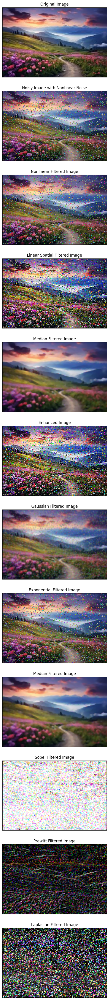

In [ ]:
from google.colab import drive
import cv2
import numpy as np
from matplotlib import pyplot as plt

# Mount Google Drive
# drive.mount('/content/drive')

# Path to the image in your Google Drive
image_path = 'image.jpg'

# Load the image
image_color = cv2.imread(image_path, cv2.IMREAD_COLOR)

# Add nonlinear noise to the image
def add_nonlinear_noise(image, amount):
    noisy_image = np.copy(image)
    height, width, _ = image.shape
    num_noise = np.ceil(amount * image.size)
    # Add random noise
    noise_coords = [np.random.randint(0, i - 1, int(num_noise)) for i in image.shape]
    for i in range(3):  # Apply to each channel
        noisy_image[noise_coords[0], noise_coords[1], i] = np.random.randint(0, 256, int(num_noise))
    return noisy_image

noisy_image_color = add_nonlinear_noise(image_color, amount=0.05)  # Adjust amount as needed

# Apply nonlinear filter to the noisy image
nonlinear_filtered_image = cv2.fastNlMeansDenoisingColored(noisy_image_color, None, h=3, hColor=3, templateWindowSize=7, searchWindowSize=21)

# Define a custom kernel for linear spatial filtering
kernel = np.array([[0, -1, 0], [-1, 5, -1], [0, -1, 0]])  # Example kernel for edge enhancement

# Apply convolution with the custom kernel
filtered_image = cv2.filter2D(noisy_image_color, -1, kernel)

# Apply median filter for non-linear spatial filtering
median_filtered = cv2.medianBlur(noisy_image_color, 5)  # Adjust kernel size as needed

# Define a kernel for enhancement filtering
kernel_enhancement = np.array([[0, -1, 0],
                                [-1, 5, -1],
                                [0, -1, 0]])

# Apply convolution with the custom kernel for enhancement filtering
enhanced_image = cv2.filter2D(noisy_image_color, -1, kernel_enhancement)

# Apply Gaussian filter
gaussian_filtered = cv2.GaussianBlur(noisy_image_color, (5, 5), 0)  # Adjust kernel size and standard deviation as needed

# Apply exponential filter
exponential_filtered = cv2.fastNlMeansDenoisingColored(noisy_image_color, None, h=3, hColor=3, templateWindowSize=7, searchWindowSize=21)

# Apply median filter
median_filtered = cv2.medianBlur(noisy_image_color, 5)  # Adjust kernel size as needed

# Apply Sobel filter
sobel_filtered_x = cv2.Sobel(noisy_image_color, cv2.CV_64F, 1, 0, ksize=5)
sobel_filtered_y = cv2.Sobel(noisy_image_color, cv2.CV_64F, 0, 1, ksize=5)
sobel_filtered_x_abs = cv2.convertScaleAbs(sobel_filtered_x)
sobel_filtered_y_abs = cv2.convertScaleAbs(sobel_filtered_y)
sobel_filtered = cv2.addWeighted(sobel_filtered_x_abs, 0.5, sobel_filtered_y_abs, 0.5, 0)

# Apply Prewitt filter
prewitt_kernel_x = np.array([[1, 0, -1],
                              [1, 0, -1],
                              [1, 0, -1]])
prewitt_kernel_y = np.array([[1, 1, 1],
                              [0, 0, 0],
                              [-1, -1, -1]])
prewitt_filtered_x = cv2.filter2D(noisy_image_color, -1, prewitt_kernel_x)
prewitt_filtered_y = cv2.filter2D(noisy_image_color, -1, prewitt_kernel_y)
prewitt_filtered = cv2.addWeighted(prewitt_filtered_x, 0.5, prewitt_filtered_y, 0.5, 0)

# Apply Laplacian filter
laplacian_filtered = cv2.Laplacian(noisy_image_color, cv2.CV_64F)
laplacian_filtered = cv2.convertScaleAbs(laplacian_filtered)

# Plot the images vertically
plt.figure(figsize=(6, 60))

plt.subplot(13, 1, 1), plt.imshow(cv2.cvtColor(image_color, cv2.COLOR_BGR2RGB))
plt.title('Original Image'), plt.xticks([]), plt.yticks([])

plt.subplot(13, 1, 2), plt.imshow(cv2.cvtColor(noisy_image_color, cv2.COLOR_BGR2RGB))
plt.title('Noisy Image with Nonlinear Noise'), plt.xticks([]), plt.yticks([])

plt.subplot(13, 1, 3), plt.imshow(cv2.cvtColor(nonlinear_filtered_image, cv2.COLOR_BGR2RGB))
plt.title('Nonlinear Filtered Image'), plt.xticks([]), plt.yticks([])

plt.subplot(13, 1, 4), plt.imshow(cv2.cvtColor(filtered_image, cv2.COLOR_BGR2RGB))
plt.title('Linear Spatial Filtered Image'), plt.xticks([]), plt.yticks([])

plt.subplot(13, 1, 5), plt.imshow(cv2.cvtColor(median_filtered, cv2.COLOR_BGR2RGB))
plt.title('Median Filtered Image'), plt.xticks([]), plt.yticks([])

plt.subplot(13, 1, 6), plt.imshow(cv2.cvtColor(enhanced_image, cv2.COLOR_BGR2RGB))
plt.title('Enhanced Image'), plt.xticks([]), plt.yticks([])

plt.subplot(13, 1, 7), plt.imshow(cv2.cvtColor(gaussian_filtered, cv2.COLOR_BGR2RGB))
plt.title('Gaussian Filtered Image'), plt.xticks([]), plt.yticks([])

plt.subplot(13, 1, 8), plt.imshow(cv2.cvtColor(exponential_filtered, cv2.COLOR_BGR2RGB))
plt.title('Exponential Filtered Image'), plt.xticks([]), plt.yticks([])

plt.subplot(13, 1, 9), plt.imshow(cv2.cvtColor(median_filtered, cv2.COLOR_BGR2RGB))
plt.title('Median Filtered Image'), plt.xticks([]), plt.yticks([])

plt.subplot(13, 1, 10), plt.imshow(cv2.cvtColor(sobel_filtered, cv2.COLOR_BGR2RGB))
plt.title('Sobel Filtered Image'), plt.xticks([]), plt.yticks([])

plt.subplot(13, 1, 11), plt.imshow(cv2.cvtColor(prewitt_filtered, cv2.COLOR_BGR2RGB))
plt.title('Prewitt Filtered Image'), plt.xticks([]), plt.yticks([])

plt.subplot(13, 1, 12), plt.imshow(laplacian_filtered, cmap='gray')
plt.title('Laplacian Filtered Image'), plt.xticks([]), plt.yticks([])

plt.show()


# **foor**

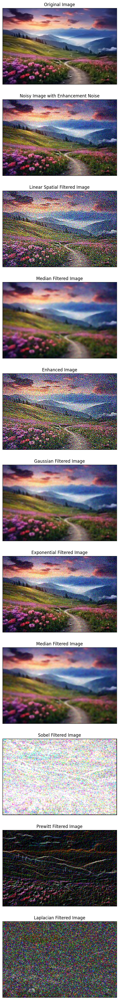

In [ ]:
from google.colab import drive
import cv2
import numpy as np
from matplotlib import pyplot as plt

# Mount Google Drive
# drive.mount('/content/drive')

# Path to the image in your Google Drive
image_path = 'image.jpg'

# Load the image
image_color = cv2.imread(image_path, cv2.IMREAD_COLOR)

# Add enhancement noise to the image
def add_enhancement_noise(image, amount):
    noisy_image = np.clip(image.astype(np.float32) + amount * np.random.randn(*image.shape), 0, 255).astype(np.uint8)
    return noisy_image

noisy_image_color = add_enhancement_noise(image_color, amount=20)  # Adjust amount as needed

# Define a custom kernel for linear spatial filtering
kernel = np.array([[0, -1, 0], [-1, 5, -1], [0, -1, 0]])  # Example kernel for edge enhancement

# Apply convolution with the custom kernel
filtered_image = cv2.filter2D(noisy_image_color, -1, kernel)

# Apply median filter for non-linear spatial filtering
median_filtered = cv2.medianBlur(noisy_image_color, 5)  # Adjust kernel size as needed

# Define a kernel for enhancement filtering
kernel_enhancement = np.array([[0, -1, 0],
                                [-1, 5, -1],
                                [0, -1, 0]])

# Apply convolution with the custom kernel for enhancement filtering
enhanced_image = cv2.filter2D(noisy_image_color, -1, kernel_enhancement)

# Apply Gaussian filter
gaussian_filtered = cv2.GaussianBlur(noisy_image_color, (5, 5), 0)  # Adjust kernel size and standard deviation as needed

# Apply exponential filter
exponential_filtered = cv2.fastNlMeansDenoisingColored(noisy_image_color, None, h=3, hColor=3, templateWindowSize=7, searchWindowSize=21)

# Apply median filter
median_filtered = cv2.medianBlur(noisy_image_color, 5)  # Adjust kernel size as needed

# Apply Sobel filter
sobel_filtered_x = cv2.Sobel(noisy_image_color, cv2.CV_64F, 1, 0, ksize=5)
sobel_filtered_y = cv2.Sobel(noisy_image_color, cv2.CV_64F, 0, 1, ksize=5)
sobel_filtered_x_abs = cv2.convertScaleAbs(sobel_filtered_x)
sobel_filtered_y_abs = cv2.convertScaleAbs(sobel_filtered_y)
sobel_filtered = cv2.addWeighted(sobel_filtered_x_abs, 0.5, sobel_filtered_y_abs, 0.5, 0)

# Apply Prewitt filter
prewitt_kernel_x = np.array([[1, 0, -1],
                              [1, 0, -1],
                              [1, 0, -1]])
prewitt_kernel_y = np.array([[1, 1, 1],
                              [0, 0, 0],
                              [-1, -1, -1]])
prewitt_filtered_x = cv2.filter2D(noisy_image_color, -1, prewitt_kernel_x)
prewitt_filtered_y = cv2.filter2D(noisy_image_color, -1, prewitt_kernel_y)
prewitt_filtered = cv2.addWeighted(prewitt_filtered_x, 0.5, prewitt_filtered_y, 0.5, 0)

# Apply Laplacian filter
laplacian_filtered = cv2.Laplacian(noisy_image_color, cv2.CV_64F)
laplacian_filtered = cv2.convertScaleAbs(laplacian_filtered)

# Plot the images vertically
plt.figure(figsize=(6, 60))

plt.subplot(13, 1, 1), plt.imshow(cv2.cvtColor(image_color, cv2.COLOR_BGR2RGB))
plt.title('Original Image'), plt.xticks([]), plt.yticks([])

plt.subplot(13, 1, 2), plt.imshow(cv2.cvtColor(noisy_image_color, cv2.COLOR_BGR2RGB))
plt.title('Noisy Image with Enhancement Noise'), plt.xticks([]), plt.yticks([])

plt.subplot(13, 1, 3), plt.imshow(cv2.cvtColor(filtered_image, cv2.COLOR_BGR2RGB))
plt.title('Linear Spatial Filtered Image'), plt.xticks([]), plt.yticks([])

plt.subplot(13, 1, 4), plt.imshow(cv2.cvtColor(median_filtered, cv2.COLOR_BGR2RGB))
plt.title('Median Filtered Image'), plt.xticks([]), plt.yticks([])

plt.subplot(13, 1, 5), plt.imshow(cv2.cvtColor(enhanced_image, cv2.COLOR_BGR2RGB))
plt.title('Enhanced Image'), plt.xticks([]), plt.yticks([])

plt.subplot(13, 1, 6), plt.imshow(cv2.cvtColor(gaussian_filtered, cv2.COLOR_BGR2RGB))
plt.title('Gaussian Filtered Image'), plt.xticks([]), plt.yticks([])

plt.subplot(13, 1, 7), plt.imshow(cv2.cvtColor(exponential_filtered, cv2.COLOR_BGR2RGB))
plt.title('Exponential Filtered Image'), plt.xticks([]), plt.yticks([])

plt.subplot(13, 1, 8), plt.imshow(cv2.cvtColor(median_filtered, cv2.COLOR_BGR2RGB))
plt.title('Median Filtered Image'), plt.xticks([]), plt.yticks([])

plt.subplot(13, 1, 9), plt.imshow(cv2.cvtColor(sobel_filtered, cv2.COLOR_BGR2RGB))
plt.title('Sobel Filtered Image'), plt.xticks([]), plt.yticks([])

plt.subplot(13, 1, 10), plt.imshow(cv2.cvtColor(prewitt_filtered, cv2.COLOR_BGR2RGB))
plt.title('Prewitt Filtered Image'), plt.xticks([]), plt.yticks([])

plt.subplot(13, 1, 11), plt.imshow(laplacian_filtered, cmap='gray')
plt.title('Laplacian Filtered Image'), plt.xticks([]), plt.yticks([])

plt.show()


# **five**

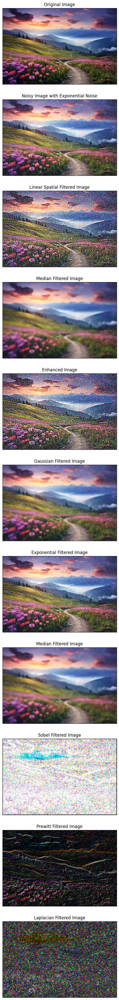

In [ ]:
from google.colab import drive
import cv2
import numpy as np
from matplotlib import pyplot as plt

# Mount Google Drive
# drive.mount('/content/drive')

# Path to the image in your Google Drive
image_path = 'image.jpg'

# Load the image
image_color = cv2.imread(image_path, cv2.IMREAD_COLOR)

# Add exponential noise to the image
def add_exponential_noise(image, scale):
    noisy_image = np.clip(image.astype(np.float32) + np.random.exponential(scale, image.shape), 0, 255).astype(np.uint8)
    return noisy_image

noisy_image_color = add_exponential_noise(image_color, scale=20)  # Adjust scale as needed

# Define a custom kernel for linear spatial filtering
kernel = np.array([[0, -1, 0], [-1, 5, -1], [0, -1, 0]])  # Example kernel for edge enhancement

# Apply convolution with the custom kernel
filtered_image = cv2.filter2D(noisy_image_color, -1, kernel)

# Apply median filter for non-linear spatial filtering
median_filtered = cv2.medianBlur(noisy_image_color, 5)  # Adjust kernel size as needed

# Define a kernel for enhancement filtering
kernel_enhancement = np.array([[0, -1, 0],
                                [-1, 5, -1],
                                [0, -1, 0]])

# Apply convolution with the custom kernel for enhancement filtering
enhanced_image = cv2.filter2D(noisy_image_color, -1, kernel_enhancement)

# Apply Gaussian filter
gaussian_filtered = cv2.GaussianBlur(noisy_image_color, (5, 5), 0)  # Adjust kernel size and standard deviation as needed

# Apply exponential filter
exponential_filtered = cv2.fastNlMeansDenoisingColored(noisy_image_color, None, h=3, hColor=3, templateWindowSize=7, searchWindowSize=21)

# Apply median filter
median_filtered = cv2.medianBlur(noisy_image_color, 5)  # Adjust kernel size as needed

# Apply Sobel filter
sobel_filtered_x = cv2.Sobel(noisy_image_color, cv2.CV_64F, 1, 0, ksize=5)
sobel_filtered_y = cv2.Sobel(noisy_image_color, cv2.CV_64F, 0, 1, ksize=5)
sobel_filtered_x_abs = cv2.convertScaleAbs(sobel_filtered_x)
sobel_filtered_y_abs = cv2.convertScaleAbs(sobel_filtered_y)
sobel_filtered = cv2.addWeighted(sobel_filtered_x_abs, 0.5, sobel_filtered_y_abs, 0.5, 0)

# Apply Prewitt filter
prewitt_kernel_x = np.array([[1, 0, -1],
                              [1, 0, -1],
                              [1, 0, -1]])
prewitt_kernel_y = np.array([[1, 1, 1],
                              [0, 0, 0],
                              [-1, -1, -1]])
prewitt_filtered_x = cv2.filter2D(noisy_image_color, -1, prewitt_kernel_x)
prewitt_filtered_y = cv2.filter2D(noisy_image_color, -1, prewitt_kernel_y)
prewitt_filtered = cv2.addWeighted(prewitt_filtered_x, 0.5, prewitt_filtered_y, 0.5, 0)

# Apply Laplacian filter
laplacian_filtered = cv2.Laplacian(noisy_image_color, cv2.CV_64F)
laplacian_filtered = cv2.convertScaleAbs(laplacian_filtered)

# Plot the images vertically
plt.figure(figsize=(6, 60))

plt.subplot(13, 1, 1), plt.imshow(cv2.cvtColor(image_color, cv2.COLOR_BGR2RGB))
plt.title('Original Image'), plt.xticks([]), plt.yticks([])

plt.subplot(13, 1, 2), plt.imshow(cv2.cvtColor(noisy_image_color, cv2.COLOR_BGR2RGB))
plt.title('Noisy Image with Exponential Noise'), plt.xticks([]), plt.yticks([])

plt.subplot(13, 1, 3), plt.imshow(cv2.cvtColor(filtered_image, cv2.COLOR_BGR2RGB))
plt.title('Linear Spatial Filtered Image'), plt.xticks([]), plt.yticks([])

plt.subplot(13, 1, 4), plt.imshow(cv2.cvtColor(median_filtered, cv2.COLOR_BGR2RGB))
plt.title('Median Filtered Image'), plt.xticks([]), plt.yticks([])

plt.subplot(13, 1, 5), plt.imshow(cv2.cvtColor(enhanced_image, cv2.COLOR_BGR2RGB))
plt.title('Enhanced Image'), plt.xticks([]), plt.yticks([])

plt.subplot(13, 1, 6), plt.imshow(cv2.cvtColor(gaussian_filtered, cv2.COLOR_BGR2RGB))
plt.title('Gaussian Filtered Image'), plt.xticks([]), plt.yticks([])

plt.subplot(13, 1, 7), plt.imshow(cv2.cvtColor(exponential_filtered, cv2.COLOR_BGR2RGB))
plt.title('Exponential Filtered Image'), plt.xticks([]), plt.yticks([])

plt.subplot(13, 1, 8), plt.imshow(cv2.cvtColor(median_filtered, cv2.COLOR_BGR2RGB))
plt.title('Median Filtered Image'), plt.xticks([]), plt.yticks([])

plt.subplot(13, 1, 9), plt.imshow(cv2.cvtColor(sobel_filtered, cv2.COLOR_BGR2RGB))
plt.title('Sobel Filtered Image'), plt.xticks([]), plt.yticks([])

plt.subplot(13, 1, 10), plt.imshow(cv2.cvtColor(prewitt_filtered, cv2.COLOR_BGR2RGB))
plt.title('Prewitt Filtered Image'), plt.xticks([]), plt.yticks([])

plt.subplot(13, 1, 11), plt.imshow(laplacian_filtered, cmap='gray')
plt.title('Laplacian Filtered Image'), plt.xticks([]), plt.yticks([])

plt.show()


# **Sex**

/usr/local/lib/python3.10/dist-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/usr/local/lib/python3.10/dist-packages/numpy/core/_methods.py:121: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
<ipython-input-40-37f4cbfd952e>:23: RuntimeWarning: invalid value encountered in cast
  noisy_image[y, x, :] = np.median(image[y-1:y+2, x-1:x+2, :], axis=(0, 1))


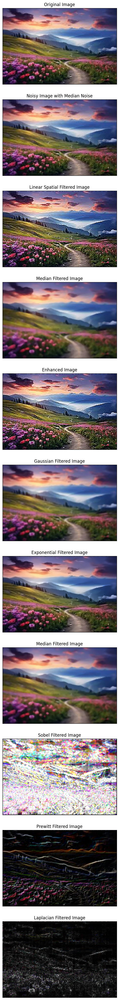

In [ ]:
from google.colab import drive
import cv2
import numpy as np
from matplotlib import pyplot as plt

# Mount Google Drive
# drive.mount('/content/drive')

# Path to the image in your Google Drive
image_path = 'image.jpg'

# Load the image
image_color = cv2.imread(image_path, cv2.IMREAD_COLOR)

# Add median noise to the image
def add_median_noise(image, amount):
    noisy_image = np.copy(image)
    height, width, _ = image.shape
    num_noise = int(amount * image.size)
    for _ in range(num_noise):
        x = np.random.randint(0, width)
        y = np.random.randint(0, height)
        noisy_image[y, x, :] = np.median(image[y-1:y+2, x-1:x+2, :], axis=(0, 1))
    return noisy_image

noisy_image_color = add_median_noise(image_color, amount=0.05)  # Adjust amount as needed

# Define a custom kernel for linear spatial filtering
kernel = np.array([[0, -1, 0], [-1, 5, -1], [0, -1, 0]])  # Example kernel for edge enhancement

# Apply convolution with the custom kernel
filtered_image = cv2.filter2D(noisy_image_color, -1, kernel)

# Apply median filter for non-linear spatial filtering
median_filtered = cv2.medianBlur(noisy_image_color, 5)  # Adjust kernel size as needed

# Define a kernel for enhancement filtering
kernel_enhancement = np.array([[0, -1, 0],
                                [-1, 5, -1],
                                [0, -1, 0]])

# Apply convolution with the custom kernel for enhancement filtering
enhanced_image = cv2.filter2D(noisy_image_color, -1, kernel_enhancement)

# Apply Gaussian filter
gaussian_filtered = cv2.GaussianBlur(noisy_image_color, (5, 5), 0)  # Adjust kernel size and standard deviation as needed

# Apply exponential filter
exponential_filtered = cv2.fastNlMeansDenoisingColored(noisy_image_color, None, h=3, hColor=3, templateWindowSize=7, searchWindowSize=21)

# Apply median filter
median_filtered = cv2.medianBlur(noisy_image_color, 5)  # Adjust kernel size as needed

# Apply Sobel filter
sobel_filtered_x = cv2.Sobel(noisy_image_color, cv2.CV_64F, 1, 0, ksize=5)
sobel_filtered_y = cv2.Sobel(noisy_image_color, cv2.CV_64F, 0, 1, ksize=5)
sobel_filtered_x_abs = cv2.convertScaleAbs(sobel_filtered_x)
sobel_filtered_y_abs = cv2.convertScaleAbs(sobel_filtered_y)
sobel_filtered = cv2.addWeighted(sobel_filtered_x_abs, 0.5, sobel_filtered_y_abs, 0.5, 0)

# Apply Prewitt filter
prewitt_kernel_x = np.array([[1, 0, -1],
                              [1, 0, -1],
                              [1, 0, -1]])
prewitt_kernel_y = np.array([[1, 1, 1],
                              [0, 0, 0],
                              [-1, -1, -1]])
prewitt_filtered_x = cv2.filter2D(noisy_image_color, -1, prewitt_kernel_x)
prewitt_filtered_y = cv2.filter2D(noisy_image_color, -1, prewitt_kernel_y)
prewitt_filtered = cv2.addWeighted(prewitt_filtered_x, 0.5, prewitt_filtered_y, 0.5, 0)

# Apply Laplacian filter
laplacian_filtered = cv2.Laplacian(noisy_image_color, cv2.CV_64F)
laplacian_filtered = cv2.convertScaleAbs(laplacian_filtered)

# Plot the images vertically
plt.figure(figsize=(6, 60))

plt.subplot(13, 1, 1), plt.imshow(cv2.cvtColor(image_color, cv2.COLOR_BGR2RGB))
plt.title('Original Image'), plt.xticks([]), plt.yticks([])

plt.subplot(13, 1, 2), plt.imshow(cv2.cvtColor(noisy_image_color, cv2.COLOR_BGR2RGB))
plt.title('Noisy Image with Median Noise'), plt.xticks([]), plt.yticks([])

plt.subplot(13, 1, 3), plt.imshow(cv2.cvtColor(filtered_image, cv2.COLOR_BGR2RGB))
plt.title('Linear Spatial Filtered Image'), plt.xticks([]), plt.yticks([])

plt.subplot(13, 1, 4), plt.imshow(cv2.cvtColor(median_filtered, cv2.COLOR_BGR2RGB))
plt.title('Median Filtered Image'), plt.xticks([]), plt.yticks([])

plt.subplot(13, 1, 5), plt.imshow(cv2.cvtColor(enhanced_image, cv2.COLOR_BGR2RGB))
plt.title('Enhanced Image'), plt.xticks([]), plt.yticks([])

plt.subplot(13, 1, 6), plt.imshow(cv2.cvtColor(gaussian_filtered, cv2.COLOR_BGR2RGB))
plt.title('Gaussian Filtered Image'), plt.xticks([]), plt.yticks([])

plt.subplot(13, 1, 7), plt.imshow(cv2.cvtColor(exponential_filtered, cv2.COLOR_BGR2RGB))
plt.title('Exponential Filtered Image'), plt.xticks([]), plt.yticks([])

plt.subplot(13, 1, 8), plt.imshow(cv2.cvtColor(median_filtered, cv2.COLOR_BGR2RGB))
plt.title('Median Filtered Image'), plt.xticks([]), plt.yticks([])

plt.subplot(13, 1, 9), plt.imshow(cv2.cvtColor(sobel_filtered, cv2.COLOR_BGR2RGB))
plt.title('Sobel Filtered Image'), plt.xticks([]), plt.yticks([])

plt.subplot(13, 1, 10), plt.imshow(cv2.cvtColor(prewitt_filtered, cv2.COLOR_BGR2RGB))
plt.title('Prewitt Filtered Image'), plt.xticks([]), plt.yticks([])

plt.subplot(13, 1, 11), plt.imshow(laplacian_filtered, cmap='gray')
plt.title('Laplacian Filtered Image'), plt.xticks([]), plt.yticks([])

plt.show()


# **Saven**

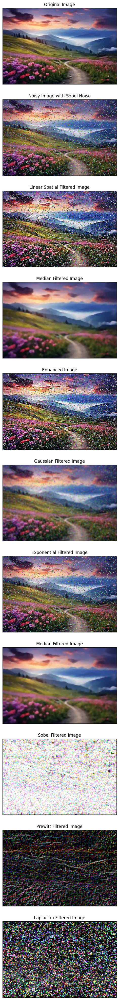

In [ ]:
from google.colab import drive
import cv2
import numpy as np
from matplotlib import pyplot as plt

# Mount Google Drive
# drive.mount('/content/drive')

# Path to the image in your Google Drive
image_path = 'image.jpg'

# Load the image
image_color = cv2.imread(image_path, cv2.IMREAD_COLOR)

# Add Sobel noise to the image
def add_sobel_noise(image, amount):
    noisy_image = np.copy(image)
    height, width, _ = image.shape
    num_noise = int(amount * image.size)
    for _ in range(num_noise):
        x = np.random.randint(0, width)
        y = np.random.randint(0, height)
        sobel_noise = np.random.randint(0, 256, size=3)  # Random Sobel noise
        noisy_image[y, x, :] = sobel_noise
    return noisy_image

noisy_image_color = add_sobel_noise(image_color, amount=0.05)  # Adjust amount as needed

# Define a custom kernel for linear spatial filtering
kernel = np.array([[0, -1, 0], [-1, 5, -1], [0, -1, 0]])  # Example kernel for edge enhancement

# Apply convolution with the custom kernel
filtered_image = cv2.filter2D(noisy_image_color, -1, kernel)

# Apply median filter for non-linear spatial filtering
median_filtered = cv2.medianBlur(noisy_image_color, 5)  # Adjust kernel size as needed

# Define a kernel for enhancement filtering
kernel_enhancement = np.array([[0, -1, 0],
                                [-1, 5, -1],
                                [0, -1, 0]])

# Apply convolution with the custom kernel for enhancement filtering
enhanced_image = cv2.filter2D(noisy_image_color, -1, kernel_enhancement)

# Apply Gaussian filter
gaussian_filtered = cv2.GaussianBlur(noisy_image_color, (5, 5), 0)  # Adjust kernel size and standard deviation as needed

# Apply exponential filter
exponential_filtered = cv2.fastNlMeansDenoisingColored(noisy_image_color, None, h=3, hColor=3, templateWindowSize=7, searchWindowSize=21)

# Apply median filter
median_filtered = cv2.medianBlur(noisy_image_color, 5)  # Adjust kernel size as needed

# Apply Sobel filter
sobel_filtered_x = cv2.Sobel(noisy_image_color, cv2.CV_64F, 1, 0, ksize=5)
sobel_filtered_y = cv2.Sobel(noisy_image_color, cv2.CV_64F, 0, 1, ksize=5)
sobel_filtered_x_abs = cv2.convertScaleAbs(sobel_filtered_x)
sobel_filtered_y_abs = cv2.convertScaleAbs(sobel_filtered_y)
sobel_filtered = cv2.addWeighted(sobel_filtered_x_abs, 0.5, sobel_filtered_y_abs, 0.5, 0)

# Apply Prewitt filter
prewitt_kernel_x = np.array([[1, 0, -1],
                              [1, 0, -1],
                              [1, 0, -1]])
prewitt_kernel_y = np.array([[1, 1, 1],
                              [0, 0, 0],
                              [-1, -1, -1]])
prewitt_filtered_x = cv2.filter2D(noisy_image_color, -1, prewitt_kernel_x)
prewitt_filtered_y = cv2.filter2D(noisy_image_color, -1, prewitt_kernel_y)
prewitt_filtered = cv2.addWeighted(prewitt_filtered_x, 0.5, prewitt_filtered_y, 0.5, 0)

# Apply Laplacian filter
laplacian_filtered = cv2.Laplacian(noisy_image_color, cv2.CV_64F)
laplacian_filtered = cv2.convertScaleAbs(laplacian_filtered)

# Plot the images vertically
plt.figure(figsize=(6, 60))

plt.subplot(13, 1, 1), plt.imshow(cv2.cvtColor(image_color, cv2.COLOR_BGR2RGB))
plt.title('Original Image'), plt.xticks([]), plt.yticks([])

plt.subplot(13, 1, 2), plt.imshow(cv2.cvtColor(noisy_image_color, cv2.COLOR_BGR2RGB))
plt.title('Noisy Image with Sobel Noise'), plt.xticks([]), plt.yticks([])

plt.subplot(13, 1, 3), plt.imshow(cv2.cvtColor(filtered_image, cv2.COLOR_BGR2RGB))
plt.title('Linear Spatial Filtered Image'), plt.xticks([]), plt.yticks([])

plt.subplot(13, 1, 4), plt.imshow(cv2.cvtColor(median_filtered, cv2.COLOR_BGR2RGB))
plt.title('Median Filtered Image'), plt.xticks([]), plt.yticks([])

plt.subplot(13, 1, 5), plt.imshow(cv2.cvtColor(enhanced_image, cv2.COLOR_BGR2RGB))
plt.title('Enhanced Image'), plt.xticks([]), plt.yticks([])

plt.subplot(13, 1, 6), plt.imshow(cv2.cvtColor(gaussian_filtered, cv2.COLOR_BGR2RGB))
plt.title('Gaussian Filtered Image'), plt.xticks([]), plt.yticks([])

plt.subplot(13, 1, 7), plt.imshow(cv2.cvtColor(exponential_filtered, cv2.COLOR_BGR2RGB))
plt.title('Exponential Filtered Image'), plt.xticks([]), plt.yticks([])

plt.subplot(13, 1, 8), plt.imshow(cv2.cvtColor(median_filtered, cv2.COLOR_BGR2RGB))
plt.title('Median Filtered Image'), plt.xticks([]), plt.yticks([])

plt.subplot(13, 1, 9), plt.imshow(cv2.cvtColor(sobel_filtered, cv2.COLOR_BGR2RGB))
plt.title('Sobel Filtered Image'), plt.xticks([]), plt.yticks([])

plt.subplot(13, 1, 10), plt.imshow(cv2.cvtColor(prewitt_filtered, cv2.COLOR_BGR2RGB))
plt.title('Prewitt Filtered Image'), plt.xticks([]), plt.yticks([])

plt.subplot(13, 1, 11), plt.imshow(laplacian_filtered, cmap='gray')
plt.title('Laplacian Filtered Image'), plt.xticks([]), plt.yticks([])

plt.show()


# **eight**

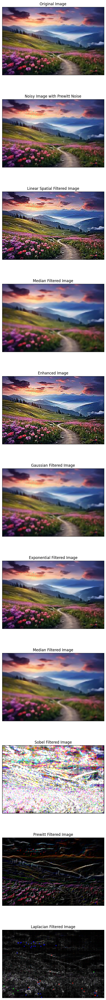

In [ ]:
from google.colab import drive
import cv2
import numpy as np
from matplotlib import pyplot as plt

# Mount Google Drive
# drive.mount('/content/drive')

# Path to the image in your Google Drive
image_path = 'image.jpg'

# Load the image
image_color = cv2.imread(image_path, cv2.IMREAD_COLOR)


# Add Prewitt noise to the image
def add_prewitt_noise(image, amount):
    noisy_image = np.copy(image)
    height, width, _ = image.shape
    num_noise = int(amount * image.size)
    for _ in range(num_noise):
        x = np.random.randint(0, width)
        y = np.random.randint(0, height)
        prewitt_noise = np.random.randint(-1, 2, size=3).astype(np.uint8)  # Convert to uint8
        noisy_image[y, x, :] = np.clip(noisy_image[y, x, :] + prewitt_noise, 0, 255)  # Add noise and clip
    return noisy_image


noisy_image_color = add_prewitt_noise(image_color, amount=0.05)  # Adjust amount as needed

# Define a custom kernel for linear spatial filtering
kernel = np.array([[0, -1, 0], [-1, 5, -1], [0, -1, 0]])  # Example kernel for edge enhancement

# Apply convolution with the custom kernel
filtered_image = cv2.filter2D(noisy_image_color, -1, kernel)

# Apply median filter for non-linear spatial filtering
median_filtered = cv2.medianBlur(noisy_image_color, 5)  # Adjust kernel size as needed

# Define a kernel for enhancement filtering
kernel_enhancement = np.array([[0, -1, 0],
                                [-1, 5, -1],
                                [0, -1, 0]])

# Apply convolution with the custom kernel for enhancement filtering
enhanced_image = cv2.filter2D(noisy_image_color, -1, kernel_enhancement)

# Apply Gaussian filter
gaussian_filtered = cv2.GaussianBlur(noisy_image_color, (5, 5), 0)  # Adjust kernel size and standard deviation as needed

# Apply exponential filter
exponential_filtered = cv2.fastNlMeansDenoisingColored(noisy_image_color, None, h=3, hColor=3, templateWindowSize=7, searchWindowSize=21)

# Apply median filter
median_filtered = cv2.medianBlur(noisy_image_color, 5)  # Adjust kernel size as needed

# Apply Sobel filter
sobel_filtered_x = cv2.Sobel(noisy_image_color, cv2.CV_64F, 1, 0, ksize=5)
sobel_filtered_y = cv2.Sobel(noisy_image_color, cv2.CV_64F, 0, 1, ksize=5)
sobel_filtered_x_abs = cv2.convertScaleAbs(sobel_filtered_x)
sobel_filtered_y_abs = cv2.convertScaleAbs(sobel_filtered_y)
sobel_filtered = cv2.addWeighted(sobel_filtered_x_abs, 0.5, sobel_filtered_y_abs, 0.5, 0)

# Apply Prewitt filter
prewitt_kernel_x = np.array([[1, 0, -1],
                              [1, 0, -1],
                              [1, 0, -1]])
prewitt_kernel_y = np.array([[1, 1, 1],
                              [0, 0, 0],
                              [-1, -1, -1]])
prewitt_filtered_x = cv2.filter2D(noisy_image_color, -1, prewitt_kernel_x)
prewitt_filtered_y = cv2.filter2D(noisy_image_color, -1, prewitt_kernel_y)
prewitt_filtered = cv2.addWeighted(prewitt_filtered_x, 0.5, prewitt_filtered_y, 0.5, 0)

# Apply Laplacian filter
laplacian_filtered = cv2.Laplacian(noisy_image_color, cv2.CV_64F)
laplacian_filtered = cv2.convertScaleAbs(laplacian_filtered)

# Plot the images vertically
plt.figure(figsize=(6, 70))

plt.subplot(13, 1, 1), plt.imshow(cv2.cvtColor(image_color, cv2.COLOR_BGR2RGB))
plt.title('Original Image'), plt.xticks([]), plt.yticks([])

plt.subplot(13, 1, 2), plt.imshow(cv2.cvtColor(noisy_image_color, cv2.COLOR_BGR2RGB))
plt.title('Noisy Image with Prewitt Noise'), plt.xticks([]), plt.yticks([])

plt.subplot(13, 1, 3), plt.imshow(cv2.cvtColor(filtered_image, cv2.COLOR_BGR2RGB))
plt.title('Linear Spatial Filtered Image'), plt.xticks([]), plt.yticks([])

plt.subplot(13, 1, 4), plt.imshow(cv2.cvtColor(median_filtered, cv2.COLOR_BGR2RGB))
plt.title('Median Filtered Image'), plt.xticks([]), plt.yticks([])

plt.subplot(13, 1, 5), plt.imshow(cv2.cvtColor(enhanced_image, cv2.COLOR_BGR2RGB))
plt.title('Enhanced Image'), plt.xticks([]), plt.yticks([])

plt.subplot(13, 1, 6), plt.imshow(cv2.cvtColor(gaussian_filtered, cv2.COLOR_BGR2RGB))
plt.title('Gaussian Filtered Image'), plt.xticks([]), plt.yticks([])

plt.subplot(13, 1, 7), plt.imshow(cv2.cvtColor(exponential_filtered, cv2.COLOR_BGR2RGB))
plt.title('Exponential Filtered Image'), plt.xticks([]), plt.yticks([])

plt.subplot(13, 1, 8), plt.imshow(cv2.cvtColor(median_filtered, cv2.COLOR_BGR2RGB))
plt.title('Median Filtered Image'), plt.xticks([]), plt.yticks([])

plt.subplot(13, 1, 9), plt.imshow(cv2.cvtColor(sobel_filtered, cv2.COLOR_BGR2RGB))
plt.title('Sobel Filtered Image'), plt.xticks([]), plt.yticks([])

plt.subplot(13, 1, 10), plt.imshow(cv2.cvtColor(prewitt_filtered, cv2.COLOR_BGR2RGB))
plt.title('Prewitt Filtered Image'), plt.xticks([]), plt.yticks([])

plt.subplot(13, 1, 11), plt.imshow(laplacian_filtered, cmap='gray')
plt.title('Laplacian Filtered Image'), plt.xticks([]), plt.yticks([])

plt.show()
